# Visualization of results for the Basque case study

In [69]:
import matplotlib.pyplot as plt  
import numpy as np
import os
import sys
import pandas as pd
import geopandas as gpd
import yaml

In [70]:
case_study_name = "cs_2025-06-27_16-14-42"
input_file_name = "transport_data_v1_ONENODE_distributed_cut_demand.yaml"

current_path = os.getcwd()
print("Current path:", current_path)
file_results = os.path.normpath(current_path + "/results")
print("File results:", os.path.normpath(file_results))
file_path = os.path.join(current_path, "/results")
print(file_path)
# Normalize the path
normalized_path = os.path.normpath(file_path)
print("Normalized path:", normalized_path)

Current path: c:\Users\Simulant\Documents\Antonia\iDesignRES\idesign_res2\iDesignRES_transcompmodel\examples\Basque country
File results: c:\Users\Simulant\Documents\Antonia\iDesignRES\idesign_res2\iDesignRES_transcompmodel\examples\Basque country\results
c:/results
Normalized path: c:\results


In [71]:
checked_path = os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_plus_dict.yaml")
if os.path.exists(checked_path):
    print(f"The path {checked_path} exists.")
else:
    print(f"The path {checked_path} does not exist.")

The path c:\Users\Simulant\Documents\Antonia\iDesignRES\idesign_res2\iDesignRES_transcompmodel\examples\Basque country\results\cs_2025-06-27_16-14-42_budget_penalty_plus_dict.yaml exists.


## Reading input data

In [72]:
folder_input = os.path.normpath(current_path + "/data")
with open(folder_input + "/" + input_file_name) as file:
    input_data = yaml.safe_load(file)

## Reading output data

In [73]:
with open(os.path.normpath(file_results + "/" + case_study_name + "_n_fueling_dict.yaml")) as file:
     n_fueling_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_minus_dict.yaml")) as file:
    budget_penalty_minus_dict = yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_plus_dict.yaml")) as file:
    budget_penalty_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_plus_yearly_dict.yaml")) as file:
    budget_penalty_plus_yearly_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_minus_yearly_dict.yaml")) as file:
    budget_penalty_minus_yearly_dict= yaml.safe_load(file)

# with open(os.path.normpath(file_results + "/" + case_study_name + "_detour_time_dict.yaml")) as file:
#     detour_time_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_f_dict.yaml")) as file:
    f_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_dict.yaml")) as file:
    h_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_exist_dict.yaml")) as file:
    h_exist_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_minus_dict.yaml")) as file:
    h_minus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_plus_dict.yaml")) as file:
    h_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_q_fuel_infr_plus_dict.yaml")) as file:
    q_fuel_infr_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_q_mode_infr_plus_dict.yaml")) as file:
    q_mode_infr_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_q_fuel_infr_plus_by_route_dict.yaml")) as file:
    q_fuel_infr_plus_by_route_dict = yaml.safe_load(file)

# with open(os.path.normpath(file_results + "/" + case_study_name + "_s_dict.yaml")) as file:
#     s_dict= yaml.safe_load(file)




In [74]:
def process_key(key):
    # Convert string key to a tuple
    return safe_tuple_parser(key)

def process_value(value):
    # Convert string value to float
    return float(value)

def safe_tuple_parser(key):
    """
    Safely parses string representations of nested 
    tuples into actual Python tuples.
    Example: "(2024, (1, 7, 0), (1, 8), 2024)" -> (2024, (1, 7, 0), (1, 8), 2024)
    """
    import ast  # Abstract Syntax Tree module for safe literal evaluation

    # Remove outer quotes if present and use `ast.literal_eval`
    try:
        return ast.literal_eval(key)
    except (SyntaxError, ValueError) as e:
        raise ValueError(f"Failed to parse key: {key}") from e



budget_penalty_minus = {process_key(key): process_value(value) for key, value in budget_penalty_minus_dict.items()}
budget_penalty_plus = {process_key(key): process_value(value) for key, value in budget_penalty_plus_dict.items()}
budget_penalty_plus_yearly = {process_key(key): process_value(value) for key, value in budget_penalty_plus_yearly_dict.items()}
budget_penalty_minus_yearly = {process_key(key): process_value(value) for key, value in budget_penalty_minus_yearly_dict.items()}
# #detour_time = {process_key(key): process_value(value) for key, value in detour_time_dict.items()}
f = {process_key(key): process_value(value) for key, value in f_dict.items()}
h = {process_key(key): process_value(value) for key, value in h_dict.items()}
h_exist = {process_key(key): process_value(value) for key, value in h_exist_dict.items()}
h_minus = {process_key(key): process_value(value) for key, value in h_minus_dict.items()}
h_plus = {process_key(key): process_value(value) for key, value in h_plus_dict.items()}
q_fuel_infr_plus = {process_key(key): process_value(value) for key, value in q_fuel_infr_plus_dict.items()}
q_fuel_infr_plus_by_route = {process_key(key): process_value(value) for key, value in q_fuel_infr_plus_by_route_dict.items()}
# q_mode_infr_plus = {process_key(key): process_value(value) for key, value in q_mode_infr_plus_dict.items()}
# s = {process_key(key): process_value(value) for key, value in s_dict.items()}
n_fueling = {process_key(key): process_value(value) for key, value in n_fueling_dict.items()}


In [75]:
tot_n = 0
for key in n_fueling.keys():
    if key[0] == 2050:
        tot_n += n_fueling[key]
print("Total number of fueling stations in 2050:", tot_n * 32)

Total number of fueling stations in 2050: 9581995.298193397


n_fueling: 10525055.356201725


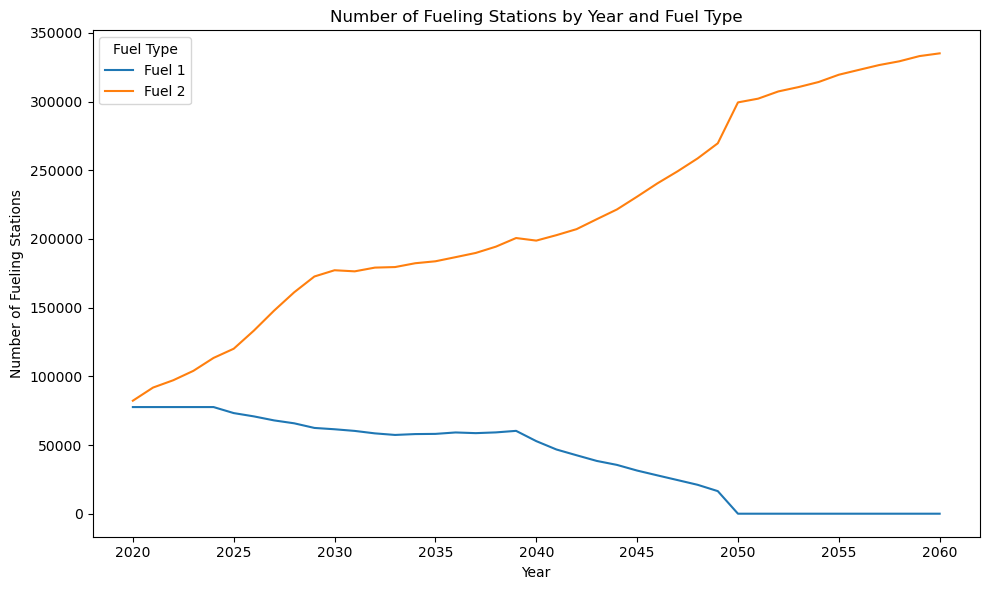

In [76]:
print("n_fueling:", sum(n_fueling.values()))

# Aggregate n_fueling by year and fuel type
n_fueling_by_year_and_fuel = {}
for key, value in n_fueling.items():
    year = key[0]
    fuel = key[2][0]
    if (year, fuel) not in n_fueling_by_year_and_fuel:
        n_fueling_by_year_and_fuel[(year, fuel)] = 0
    n_fueling_by_year_and_fuel[(year, fuel)] += value

# Prepare data for plotting
fuel_types = list(set(fuel for _, fuel in n_fueling_by_year_and_fuel.keys()))
years = range(y_init, y + 1)
data = {fuel: [n_fueling_by_year_and_fuel.get((year, fuel), 0) for year in years] for fuel in fuel_types}

# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))
for fuel, values in data.items():
    ax.plot(years, values, label=f"Fuel {fuel}")

ax.set_xlabel('Year')
ax.set_ylabel('Number of Fueling Stations')
ax.set_title('Number of Fueling Stations by Year and Fuel Type')
ax.legend(title='Fuel Type')
plt.tight_layout()
plt.show()

In [77]:
print(sum(budget_penalty_minus.values()))
print(sum(budget_penalty_plus.values()))
print(sum(budget_penalty_plus_yearly.values()))
print(sum(budget_penalty_minus_yearly.values()))

0.0
0.0
-1e-06
2.0000000000000005e-05


In [78]:
for key in f.keys():
    if key[0] == 2050 and f[key] > 0:
        print(key, f[key])

(2050, (1, 7, 0), (1, 5), 2049) 475.449537
(2050, (1, 6, 0), (1, 5), 2047) 160.176793
(2050, (1, 5, 0), (1, 7), 2047) 750.653397
(2050, (1, 22, 7), (1, 7), 2049) 125.541401
(2050, (1, 15, 0), (1, 7), 2048) 259.137147
(2050, (1, 34, 7), (1, 5), 2049) 129.792359
(2050, (1, 23, 7), (1, 5), 2047) 93.160366
(2050, (1, 0, 0), (1, 5), 2040) 80.794764
(2050, (1, 36, 7), (1, 5), 2049) 708.220035
(2050, (1, 27, 7), (1, 5), 2041) 1543.827456
(2050, (1, 12, 0), (1, 5), 2046) 183.008378
(2050, (1, 11, 0), (1, 7), 2048) 732.422232
(2050, (1, 24, 7), (1, 7), 2050) 1776.170412
(2050, (1, 21, 0), (1, 3), 2047) 105.751327
(2050, (1, 15, 0), (1, 5), 2041) 173.557631
(2050, (1, 10, 0), (1, 7), 2046) 367.414553
(2050, (1, 21, 0), (1, 3), 2048) 399.696144
(2050, (1, 27, 7), (1, 7), 2047) 3154.200742
(2050, (1, 2, 0), (1, 5), 2050) 394.955822
(2050, (1, 25, 7), (1, 5), 2047) 346.379609
(2050, (1, 18, 0), (1, 5), 2048) 312.109274
(2050, (1, 25, 7), (1, 7), 2049) 357.127157
(2050, (1, 37, 7), (1, 5), 2040) 139

In [79]:
for key in h.keys():
    if key[0] == 2050 and h[key] > 0:
        print(key, h[key])

(2050, 39, 7, 2050) 5481.258858
(2050, 38, 7, 2048) 2410.692202
(2050, 35, 7, 2050) 170.644597
(2050, 15, 5, 2040) 30.812285
(2050, 15, 5, 2042) 57.223215
(2050, 22, 5, 2042) 69.98793
(2050, 1, 7, 2050) 1953.698094
(2050, 13, 7, 2049) 304.059144
(2050, 9, 7, 2050) 778.137748
(2050, 24, 5, 2046) 180.045853
(2050, 26, 3, 2049) 704.885471
(2050, 14, 3, 2048) 663.115298
(2050, 39, 7, 2049) 1817.833886
(2050, 26, 7, 2050) 452.584631
(2050, 21, 3, 2048) 365.511379
(2050, 13, 3, 2046) 132.819436
(2050, 17, 5, 2047) 26.606371
(2050, 38, 7, 2050) 3344.127631
(2050, 7, 7, 2049) 1009.742384
(2050, 25, 5, 2049) 1306.946418
(2050, 17, 7, 2049) 436.000971
(2050, 15, 5, 2041) 158.713787
(2050, 5, 5, 2040) 63.895255
(2050, 11, 5, 2047) 79.241607
(2050, 36, 5, 2050) 500.626072
(2050, 36, 5, 2049) 647.648182
(2050, 27, 7, 2046) 2612.700776
(2050, 39, 5, 2047) 108.259778
(2050, 31, 3, 2048) 5176.636141
(2050, 1, 5, 2047) 167.55781
(2050, 14, 3, 2049) 655.094325
(2050, 18, 3, 2046) 116.32013
(2050, 36, 7,

## Visualizations

- cummulative shift (vehicle stock after different types and technologies) (check!)
- shift by income class (check!)
- mode shift (check!)
- infrastructure expansion by year for each technology (check!)
- *impact of route length*

In [80]:
print(input_data.keys())
model_parameters = input_data["Model"]
print(model_parameters)

Y = model_parameters["Y"]
y_init = model_parameters["y_init"]
pre_y = model_parameters["pre_y"]

G = pre_y + Y
g_init = y_init - pre_y
Y_end = y_init + Y - 1


dict_keys(['DetourTimeReduction', 'Edge', 'FinancialStatus', 'Fuel', 'FuelingInfrTypes', 'GeographicElement', 'InitDetourTime', 'InitialFuelingInfr', 'InitialModeInfr', 'InitialVehicleStock', 'Initial_Mode_Share', 'Market_shares', 'MaximumFuelingCapacityByType', 'Mode', 'Model', 'Node', 'Odpair', 'Path', 'Product', 'Regiontype', 'Speed', 'TechVehicle', 'Technology', 'TripRatio', 'Vehicletype'])
{'E': 12, 'N': 2, 'Y': 41, 'budget_penalty_minus': 100000, 'budget_penalty_plus': 100000, 'budget_penalty_yearly_minus': 100000, 'budget_penalty_yearly_plus': 100000, 'discount_rate': 0.05, 'gamma': 0.0003, 'goals_no_new_ICEV': {2035: 0.0}, 'goals_tot_BEV': {2030: 230.0}, 'investment_period': 5, 'pre_y': 25, 'y_init': 2020}


In [81]:
# print(input_data.keys())
fuel_list = input_data["Fuel"]
mode_list = input_data["Mode"]
techvehicle_list = input_data["TechVehicle"]
odpair_list = input_data["Odpair"]  
financial_status_list = input_data["FinancialStatus"]

od_pair_list_by_year = {}
for y in range(y_init, Y_end + 1):

    od_pair_list_by_year[y] = sum(odpair_list[r]["F"][y - y_init] for r in range(0, len(odpair_list)))


fuel_list = {item["id"]: item for item in fuel_list}
fuel_infr_type_list = {item["id"]: item for item in input_data["FuelingInfrTypes"]}
mode_list = {item["id"]: item for item in mode_list}
techvehicle_list = {item["id"]: item for item in techvehicle_list}
odpair_list = {item["id"]: item for item in odpair_list}
financial_status_list = {item["id"]: item for item in financial_status_list}

# calculating for each technology and each year the total cost
def get_vehicle_stock(by_income_class = False, income_class=None):
    techveh_stock = {}

    for tv_id in techvehicle_list:

        for y in range(y_init, Y_end + 1):
            if not by_income_class:
                total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r, tv_id, g) in h.keys())
            else:
                total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r, tv_id, g) in h.keys())
            techveh_stock[(y, tv_id)] = total_veh_number
    return techveh_stock

In [82]:
# color palette defintion"
colors_techvehicles = ["#f7b267", "#76c893", "#c0b9dd", "#4f5d75", "#c9ada7", "#9a8c98", "#8e9aaf", "#8b8c89", "#463f3a", "#595959", "#604d53"]

In [83]:
print(sum(od_pair_list_by_year.values()))



26530305659.446907


In [84]:
veh_stock = get_vehicle_stock(True, "Commercial")
print(veh_stock)

{(2020, 0): 1831.7071859999996, (2021, 0): 1240.9413399999999, (2022, 0): 688.288462, (2023, 0): 174.582743, (2024, 0): 174.582743, (2025, 0): 157.124469, (2026, 0): 157.124469, (2027, 0): 0.0, (2028, 0): 0.0, (2029, 0): 0.0, (2030, 0): 0.0, (2031, 0): 0.0, (2032, 0): 0.0, (2033, 0): 0.0, (2034, 0): 0.0, (2035, 0): 0.0, (2036, 0): 0.0, (2037, 0): 0.0, (2038, 0): 0.0, (2039, 0): 0.0, (2040, 0): 0.0, (2041, 0): 0.0, (2042, 0): 0.0, (2043, 0): 0.0, (2044, 0): 0.0, (2045, 0): 0.0, (2046, 0): 0.0, (2047, 0): 0.0, (2048, 0): 0.0, (2049, 0): 0.0, (2050, 0): 0.0, (2051, 0): 0.0, (2052, 0): 0.0, (2053, 0): 0.0, (2054, 0): 0.0, (2055, 0): 0.0, (2056, 0): 0.0, (2057, 0): 0.0, (2058, 0): 0.0, (2059, 0): 0.0, (2060, 0): 0.0, (2020, 1): 796.578028, (2021, 1): 1283.8309570000001, (2022, 1): 1840.772797, (2023, 1): 2469.726949, (2024, 1): 2815.2690049999997, (2025, 1): 3553.5825269999996, (2026, 1): 3909.2919049999996, (2027, 1): 4526.379167, (2028, 1): 4836.629627, (2029, 1): 4866.950318000001, (2030

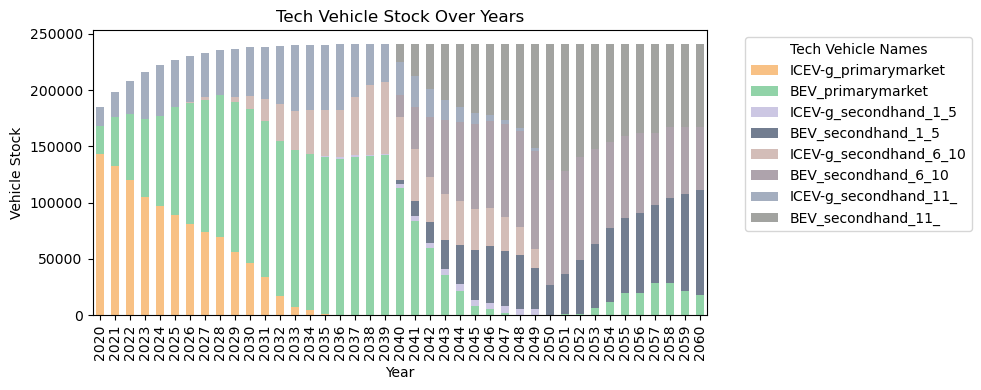

{2020: [143229.854397,
  24788.179866000006,
  0.0,
  0.0,
  0.0,
  0.0,
  17488.939273,
  0.0],
 2021: [132284.0545309999,
  43501.82189600002,
  0.0,
  0.0,
  0.0,
  0.0,
  22608.778051999998,
  0.0],
 2022: [120212.72605299985,
  58899.54989100004,
  0.0,
  0.0,
  0.0,
  0.0,
  29486.302641,
  0.0],
 2023: [105102.56187299994,
  69550.53160900003,
  0.0,
  0.0,
  0.0,
  0.0,
  41888.242823,
  0.0],
 2024: [97231.88481399999,
  80067.65392400003,
  0.0,
  0.0,
  0.0,
  0.0,
  45345.923722,
  0.0],
 2025: [88761.03269900003,
  96209.60003800005,
  0.0,
  0.0,
  37.933913,
  0.0,
  42283.324264,
  0.0],
 2026: [81386.09418200002,
  107586.96588700007,
  0.0,
  0.0,
  665.515558,
  0.0,
  41164.97208700001,
  0.0],
 2027: [73655.03131199999,
  117663.57260100007,
  0.0,
  0.0,
  2850.6066599999995,
  0.0,
  39274.27266800001,
  0.0],
 2028: [69503.16195299997,
  126075.25393300006,
  0.0,
  0.0,
  0.0,
  0.0,
  39841.83359499999,
  0.0],
 2029: [56018.88902199997,
  133796.69921800005,


In [85]:
tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
fig, ax = plt.subplots(figsize=(10, 4))

years = range(y_init, Y_end + 1)
tech_ids = list(techvehicle_list.keys())

techveh_stock_all = get_vehicle_stock()

# Prepare data for stacked bar plot
data = {year: [techveh_stock_all.get((year, tech_id), 0) for tech_id in tech_ids] for year in years}
df = pd.DataFrame(data, index=tech_ids).T

# Plotting
bars = df.plot(kind='bar', stacked=True, ax=ax, color=colors_techvehicles, alpha=0.8)
ax.set_xlabel('Year')
ax.set_ylabel('Vehicle Stock')
ax.set_title('Tech Vehicle Stock Over Years')

handles, _ = ax.get_legend_handles_labels()
ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')
 # plt.legend(title='Tech Vehicle ID', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

data

2020 0 40498.00913899999
2021 0 23909.150810999992
2022 0 22350.922582000003
2023 0 48591.61807300001
2024 0 17096.958933000005
2025 0 35272.979596000005
2026 0 17032.715988999997
2027 0 27841.552689000004
2028 0 21688.251762999993
2029 0 32703.799135000005
2030 0 22280.309390999988
2031 0 35254.39635699999
2032 0 32286.914436999992
2033 0 40884.848477
2034 0 23902.198777
2035 0 29753.667558
2036 0 16166.898062
2037 0 38891.379686
2038 0 29180.161030999996
2039 0 26218.132919
2040 0 45509.057171
2041 0 58802.08220100002
2042 0 42782.575826000015
2043 0 57419.54523
2044 0 34389.787389000005
2045 0 66781.244141
2046 0 50561.24207799999
2047 0 50559.017585
2048 0 37463.782111999986
2049 0 79883.021296
2050 0 92812.63989399999
2051 0 47961.871732
2052 0 26420.958028999998
2053 0 61567.228864000026
2054 0 20969.365945
2055 0 109900.81869799997
2056 0 22178.732438000003
2057 0 37067.51529699999
2058 0 27778.321371
2059 0 34602.698141
2060 0 19128.606819
2020 1 8156.170000000002
2021 1 40498.

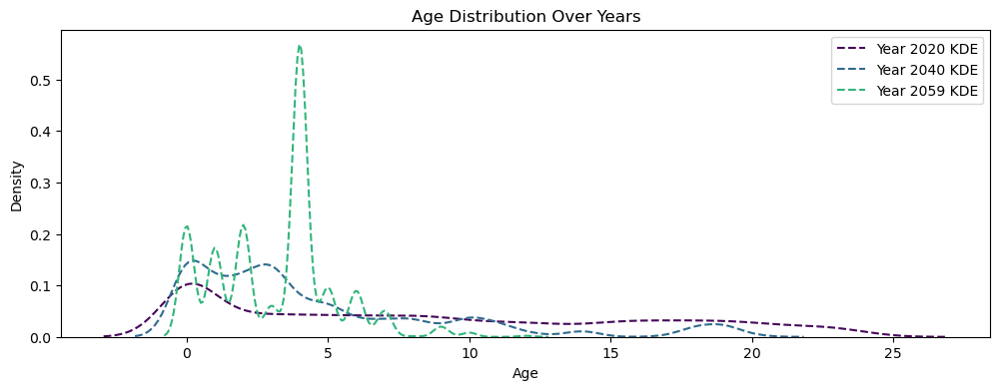

In [86]:
import scipy.stats as stats
import seaborn as sns
# If running in a Jupyter notebook, use the following to install packages:

# determining technology share in each year + age strucuture
age_distribution_per_year = {}
ages = []
for y in range(y_init, Y_end + 1):
    total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    for g in range(g_init, y+1):
        curr_veh_nb = sum(h[(y, r, tv_id, g)] for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        age = y - g
        if (y, age) in age_distribution_per_year.keys():
            age_distribution_per_year[(y, age)] += curr_veh_nb
        else:
            age_distribution_per_year[(y, age)] = curr_veh_nb
        ages.append(age)

for age in range(0, max(ages)):
    for y in range(y_init, Y_end + 1):
        if (y, age) not in age_distribution_per_year.keys():
            age_distribution_per_year[(y, age)] = 0
        print(y, age, age_distribution_per_year[(y, age)])

# Create a list of hex codes with different colors
print(age_distribution_per_year)
color_palette = sns.color_palette("viridis", 60).as_hex()
fig, ax = plt.subplots(figsize=(12, 4))
for y in range(y_init, Y_end + 1):
    if y in [2020, 2040, 2059]:
        # Create a DataFrame for the current year
        age_distribution_per_year[y] = {age: age_distribution_per_year[(y, age)] for age in range(0, max(ages)) if (y, age) in age_distribution_per_year.keys()}
        curr_distribution = age_distribution_per_year[y]

        df = pd.DataFrame(list(curr_distribution.items()), columns=["Age", "Count"])
        df = df.apply(pd.to_numeric, errors="coerce")  # Convert to numbers, set invalid to NaN
        df.dropna(inplace=True)  # Drop NaN values
        # Expand data by repeating ages according to their counts
        expanded_ages = np.repeat(df["Age"], df["Count"])

        # Fit a Normal Distribution
        mu, sigma = stats.norm.fit(expanded_ages)

        # Generate x values for PDF
        x = np.linspace(min(df["Age"]), max(df["Age"]), 100)
        pdf = stats.norm.pdf(x, mu, sigma)

        # Plot KDE & Normal Fit
        sns.kdeplot(expanded_ages, bw_adjust=1.5, label=f"Year {y} KDE", linestyle="dashed", color=color_palette[y - y_init])
        # plt.plot(x, pdf, label=f"Year {y} Fit (μ={mu:.1f}, σ={sigma:.1f})", color=color_palette[y - y_init])

# Formatting the plot
plt.title("Age Distribution Over Years")
plt.xlabel("Age")
plt.ylabel("Density")
plt.legend()

plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_age_distribution.png"), transparent=True)
for y in range(y_init, Y_end + 1):
    for age in range(0, max(ages)):
        print(y, age, age_distribution_per_year[(y, age)])
    

2020 2060


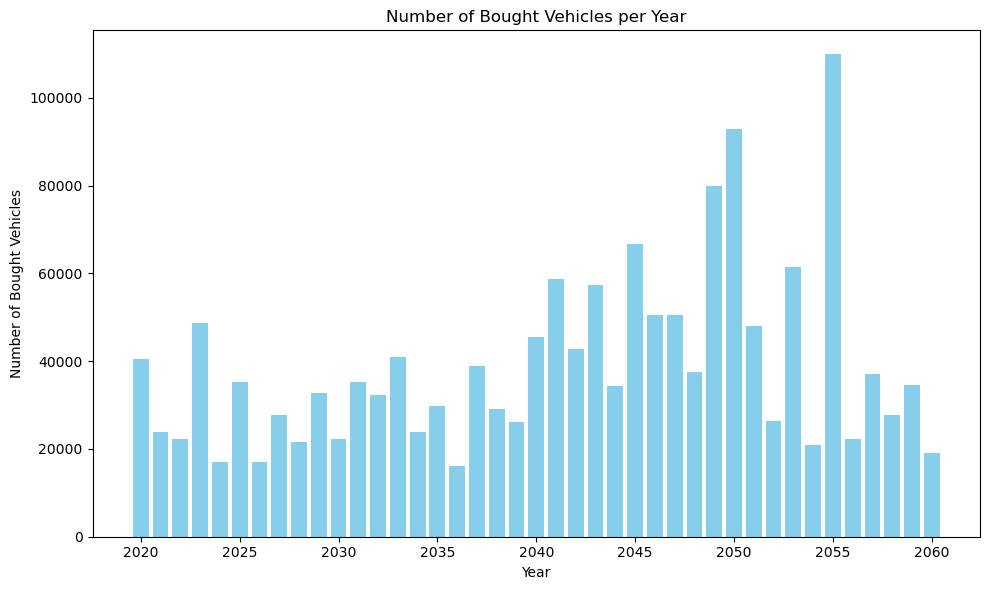

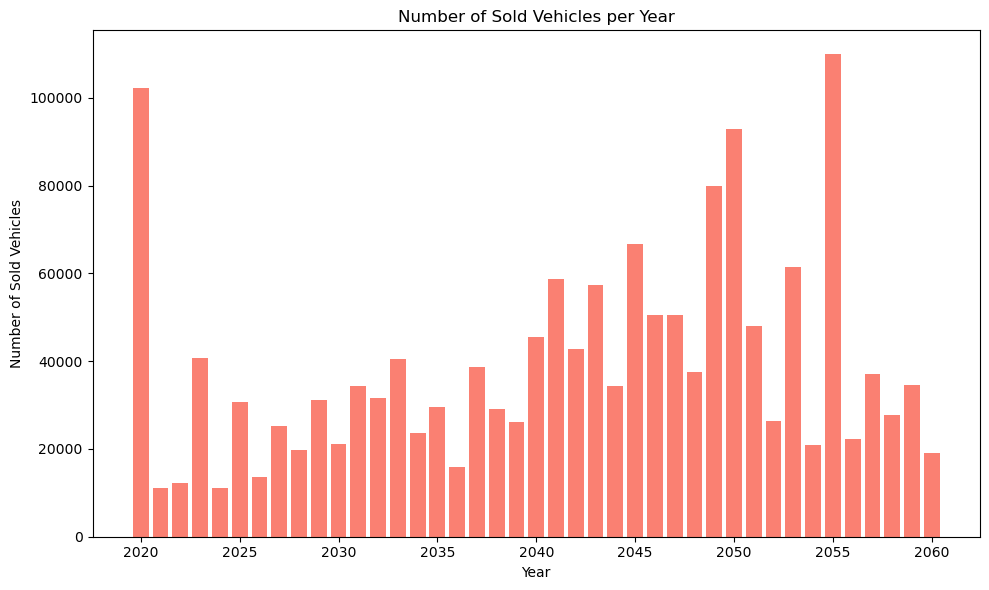

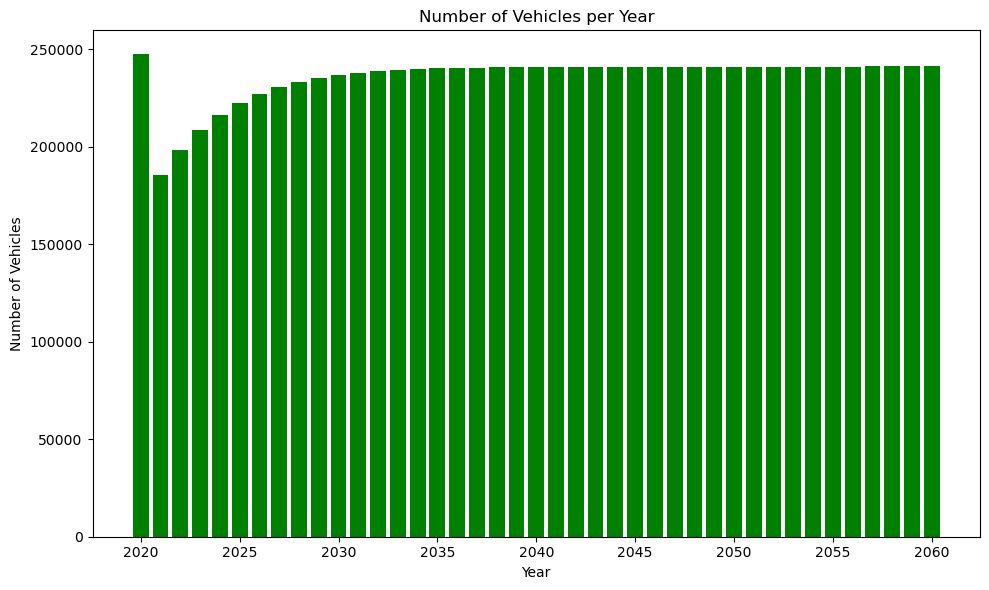

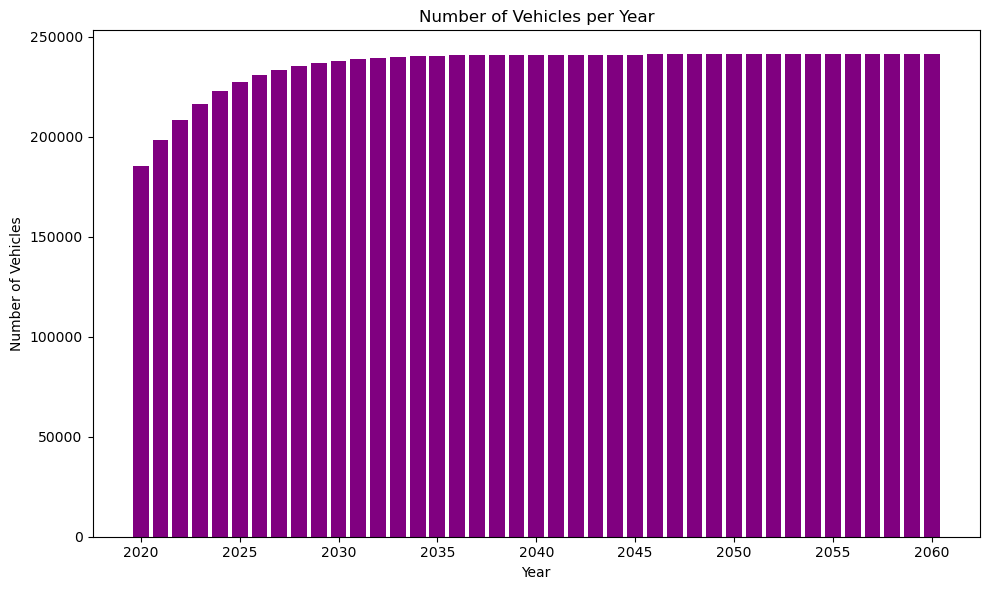

In [87]:
# ANALYSIS OF BOUGHT AND SOLD VEHICLES 
bought_vehicles = {}
exiting_vehicles = {}
h_now = {}
h_all = {}
print(y_init, Y_end)
for y in range(y_init, Y_end + 1):
    total_veh_number = sum(h_plus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    bought_vehicles[y] = total_veh_number
    total_veh_number = sum(h_minus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    exiting_vehicles[y] = total_veh_number
    total_veh_number = sum(h_exist[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    h_now[y] = total_veh_number
    total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    h_all[y] = total_veh_number

fig, ax = plt.subplots(figsize=(10, 6))

years = range(y_init, Y_end + 1)
bought_values = [bought_vehicles[year] for year in years]

ax.bar(years, bought_values, color='skyblue')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Bought Vehicles')
ax.set_title('Number of Bought Vehicles per Year')

plt.tight_layout()
plt.show()

sold_values = [exiting_vehicles[year] for year in years]

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(years, sold_values, color='salmon')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Sold Vehicles')
ax.set_title('Number of Sold Vehicles per Year')

plt.tight_layout()
plt.show()

h_now_values = [h_now[year] for year in years]

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(years, h_now_values, color='green')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Vehicles')
ax.set_title('Number of Vehicles per Year')
plt.tight_layout()
plt.show()

h_all_values = [h_all[year] for year in years]

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(years, h_all_values, color='purple')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Vehicles')
ax.set_title('Number of Vehicles per Year')
plt.tight_layout()
plt.show()

{(2044, 36): 0.0, (2058, 26): 0.0, (2055, 28): 0.0, (2032, 20): 0.0, (2045, 12): 0.0, (2059, 36): 0.0, (2060, 10): 0.0, (2021, 7): 0.0, (2046, 21): 0.0, (2057, 5): 0.0, (2033, 37): 0.0, (2044, 8): 0.0, (2027, 6): 0.0, (2039, 18): 0.0, (2056, 24): 0.0, (2033, 28): 0.0, (2036, 13): 0.0, (2022, 29): 0.0, (2059, 2): 0.0, (2021, 0): 0.0, (2023, 29): 0.0, (2027, 24): 0.0, (2060, 29): 0.0, (2046, 13): 0.0, (2048, 30): 0.0, (2031, 11): 0.0, (2022, 12): 0.0, (2032, 30): 0.0, (2044, 24): 0.0, (2046, 3): 0.0, (2024, 26): 0.0, (2039, 23): 0.0, (2056, 33): 0.0, (2060, 8): 0.0, (2055, 25): 0.0, (2022, 15): 0.0, (2046, 19): 0.0, (2032, 34): 0.0, (2034, 21): 0.0, (2054, 26): 0.0, (2059, 1): 0.0, (2041, 19): 0.0, (2036, 18): 0.0, (2059, 7): 0.0, (2056, 38): 0.0, (2030, 38): 0.0, (2031, 1): 0.0, (2041, 37): 0.0, (2030, 37): 0.0, (2022, 19): 0.0, (2049, 29): 0.0, (2060, 20): 0.0, (2020, 29): 0.0, (2028, 20): 0.0, (2055, 27): 0.0, (2023, 26): 0.0, (2022, 35): 0.0, (2042, 6): 0.0, (2057, 7): 0.0, (2029, 10

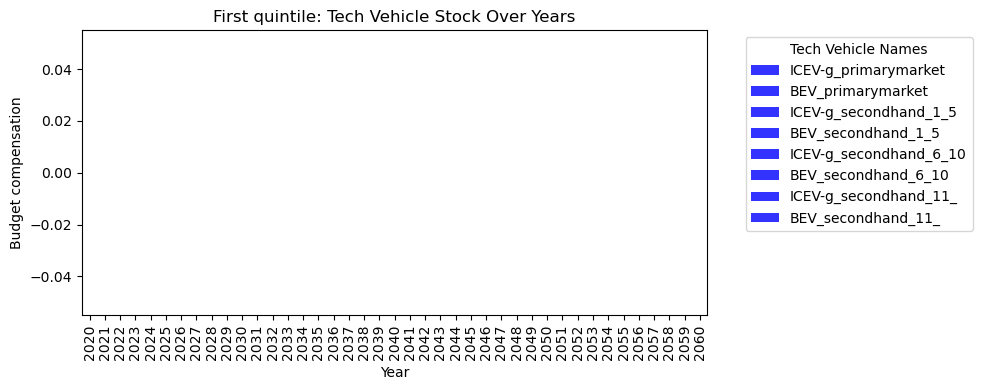

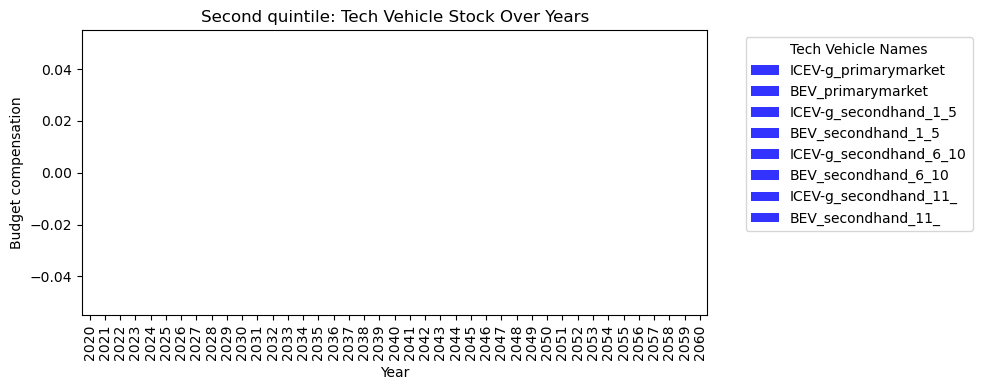

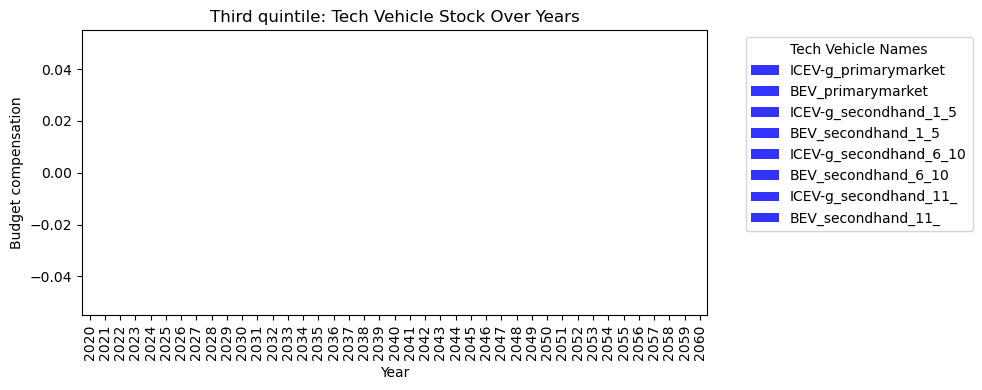

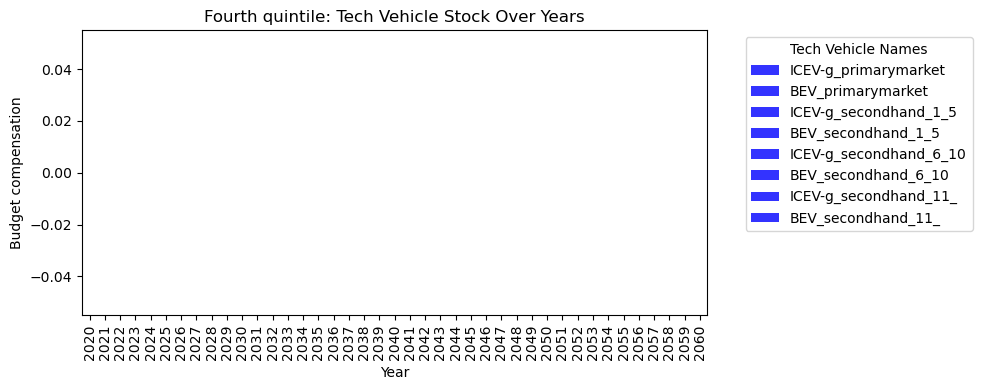

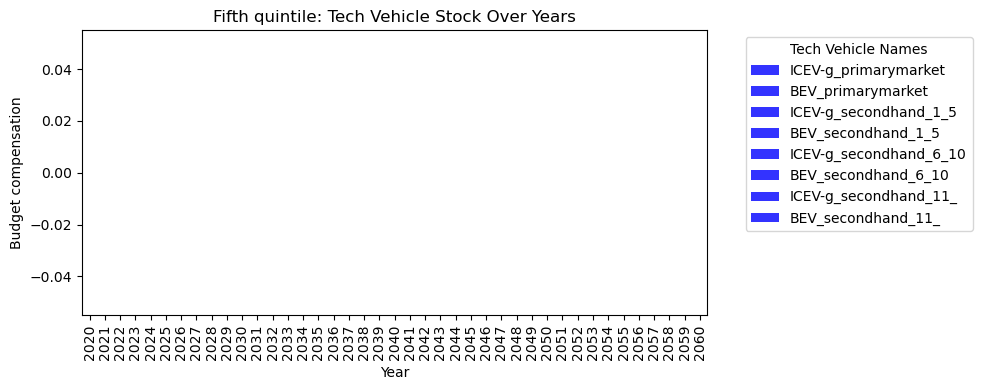

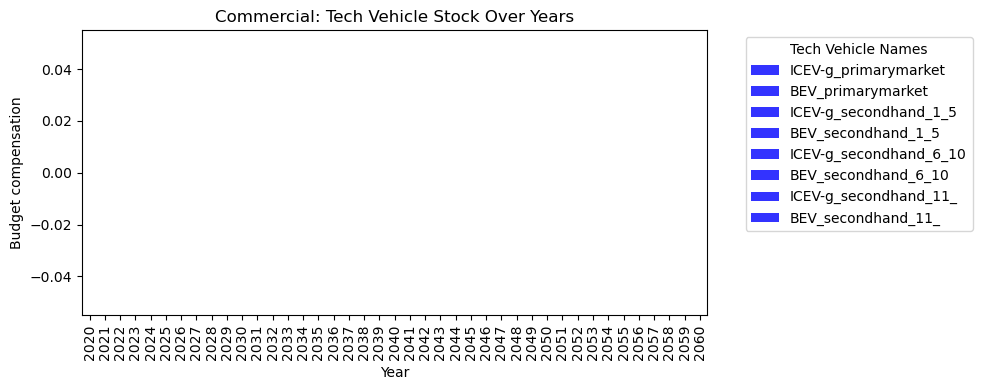

In [88]:
# looking a budget penalties
def get_budget_penalty_total(by_income_class = False, income_class=None):
    budget_pen = {}

    # for tv_id in techvehicle_list:

    for y in range(y_init, Y_end + 1):
        if not by_income_class:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
        else:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
    return budget_pen

financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year))]for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Budget compensation')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
print(budget_penalty_plus)


In [89]:
print(f.keys())

dict_keys([(2023, (1, 4, 0), (1, 1), 2015), (2058, (1, 20, 0), (1, 3), 2039), (2020, (1, 5, 0), (1, 0), 2002), (2044, (1, 1, 0), (1, 0), 2009), (2052, (1, 2, 0), (1, 0), 1995), (2059, (1, 9, 0), (1, 6), 2009), (2040, (1, 17, 0), (1, 5), 2018), (2038, (1, 19, 0), (1, 1), 2020), (2045, (1, 9, 0), (1, 5), 2013), (2020, (1, 15, 0), (1, 4), 2015), (2042, (1, 31, 7), (1, 3), 2025), (2051, (1, 17, 0), (1, 7), 2026), (2043, (1, 36, 7), (1, 5), 2026), (2037, (1, 15, 0), (1, 3), 2017), (2047, (1, 34, 7), (1, 3), 2023), (2035, (1, 0, 0), (1, 5), 2017), (2027, (1, 1, 0), (1, 3), 2000), (2052, (1, 34, 7), (1, 3), 2030), (2026, (1, 26, 7), (1, 5), 2020), (2041, (1, 8, 0), (1, 3), 2032), (2051, (1, 29, 7), (1, 6), 2018), (2044, (1, 14, 0), (1, 0), 2043), (2049, (1, 39, 7), (1, 1), 2014), (2050, (1, 33, 7), (1, 3), 2041), (2021, (1, 35, 7), (1, 1), 2014), (2053, (1, 7, 0), (1, 1), 2046), (2046, (1, 5, 0), (1, 5), 2002), (2040, (1, 23, 7), (1, 0), 2030), (2058, (1, 25, 7), (1, 3), 2052), (2043, (1, 36,

2020 2060


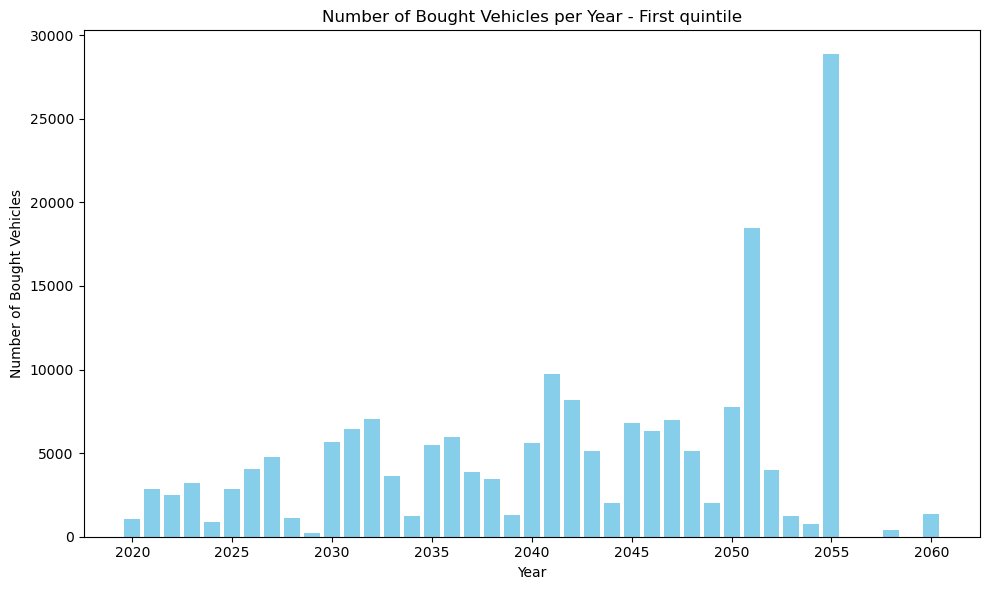

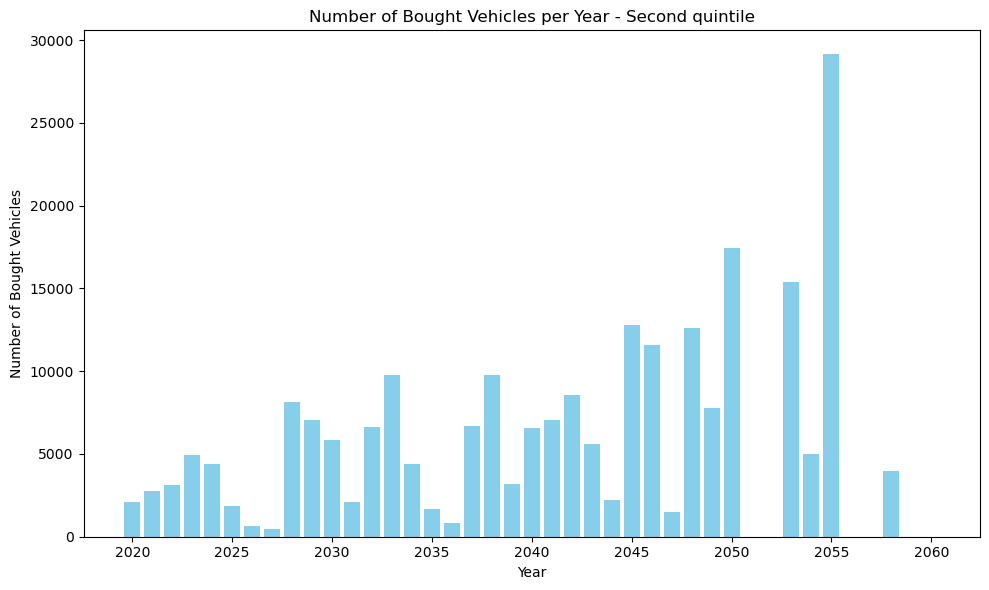

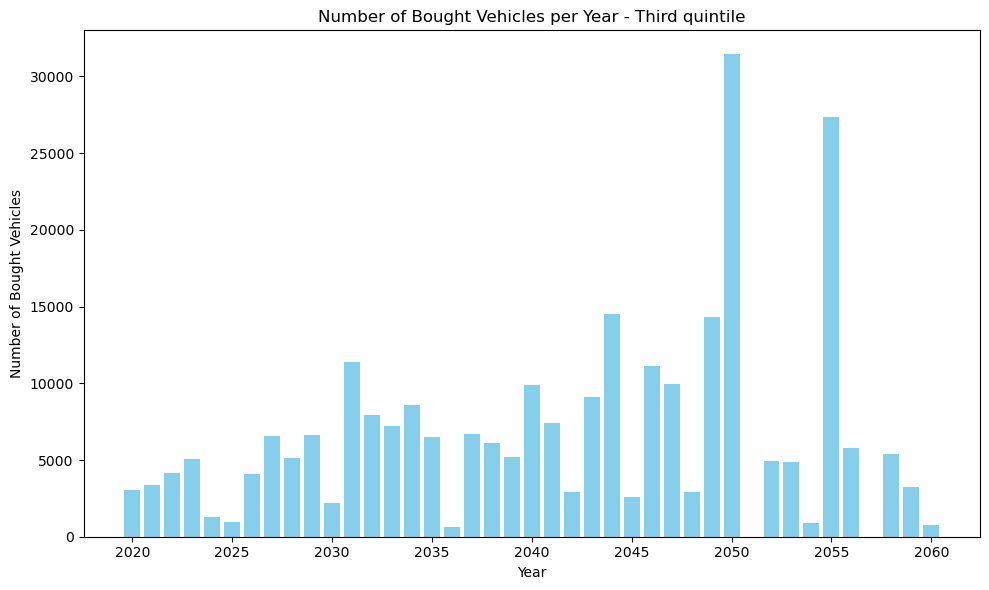

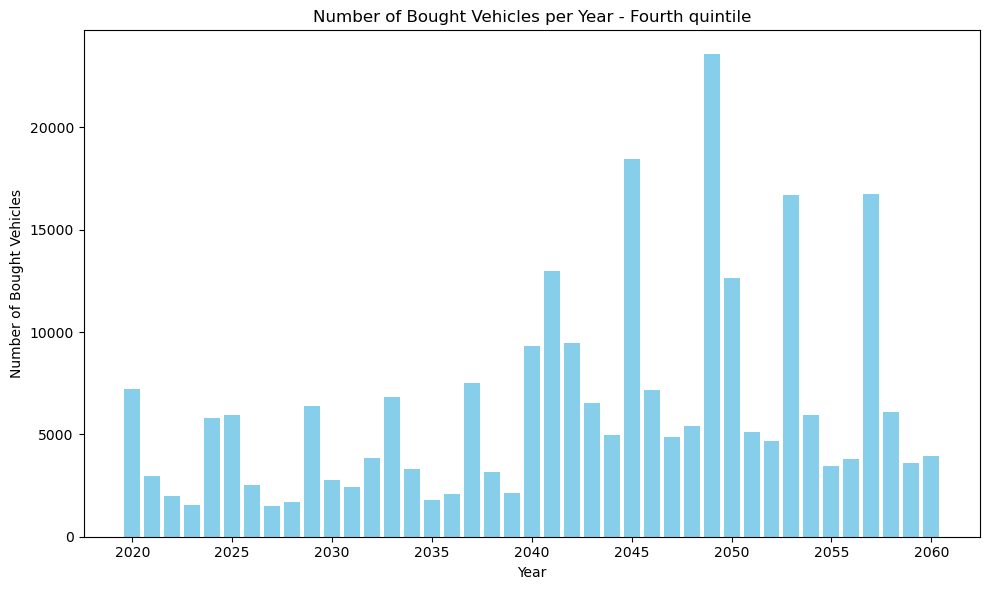

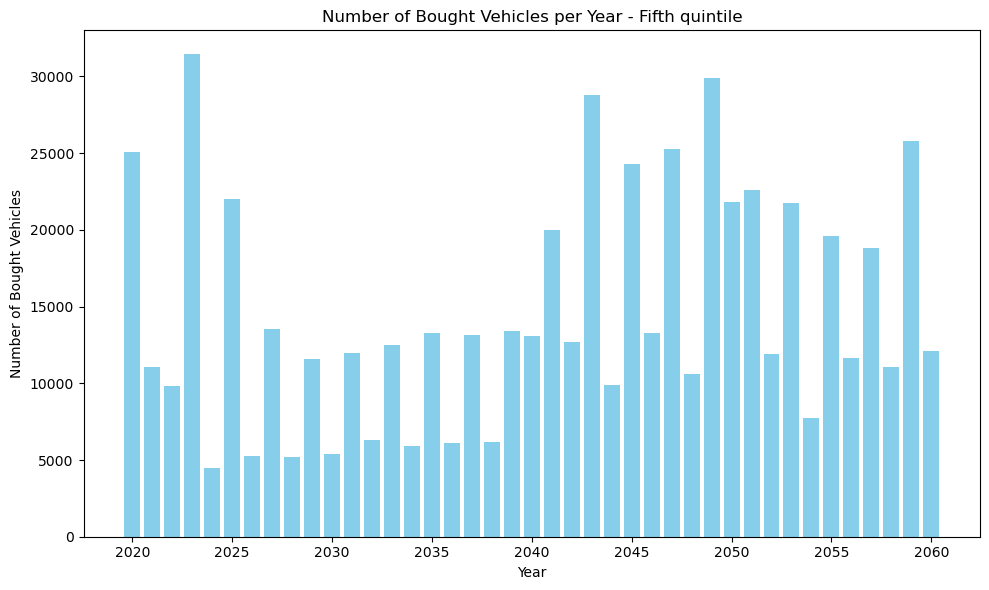

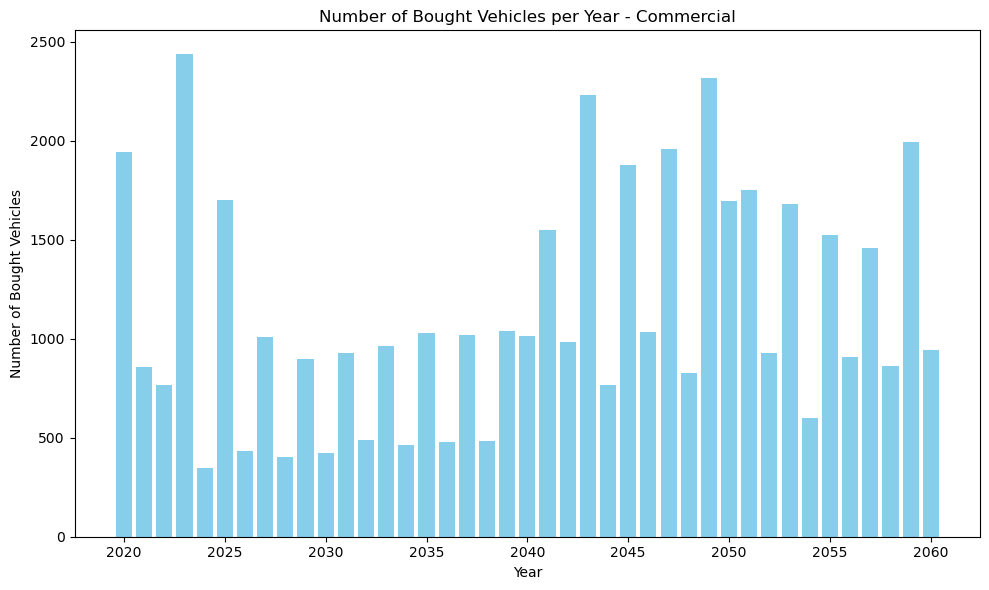

In [90]:
# purchases by income class
financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}


print(y_init, Y_end)
for fin in financial_status_list.keys():
    bought_vehicles = {}
    exiting_vehicles = {}
    h_now = {}
    h_all = {}
    income_class = financial_status_list[fin]["name"]
    for y in range(y_init, Y_end + 1):
        total_veh_number = sum(h_plus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r, tv_id, g) in h.keys())
        bought_vehicles[y] = total_veh_number
        total_veh_number = sum(h_minus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        exiting_vehicles[y] = total_veh_number
        total_veh_number = sum(h_exist[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        h_now[y] = total_veh_number
        total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        h_all[y] = total_veh_number

    fig, ax = plt.subplots(figsize=(10, 6))

    years = range(y_init, Y_end + 1)
    bought_values = [bought_vehicles[year] for year in years]

    ax.bar(years, bought_values, color='skyblue')
    ax.set_xlabel('Year')
    ax.set_ylabel('Number of Bought Vehicles')
    ax.set_title('Number of Bought Vehicles per Year - ' + income_class)

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_bought_vehicles_" + income_class + ".png"), transparent=True)

In [91]:
tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]

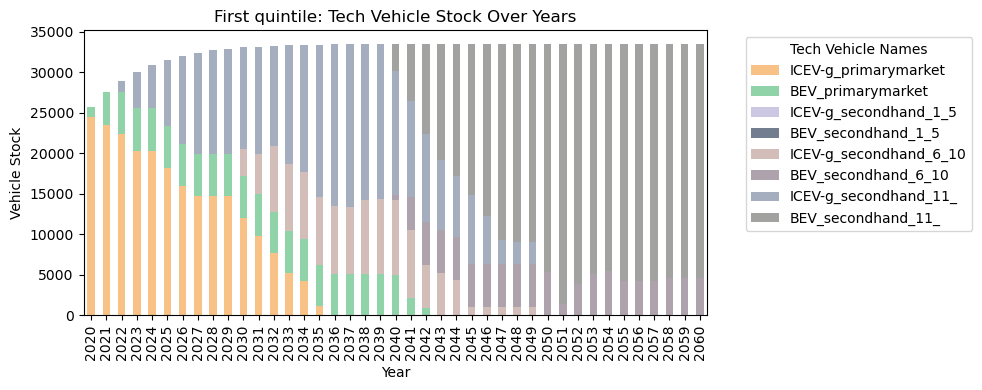

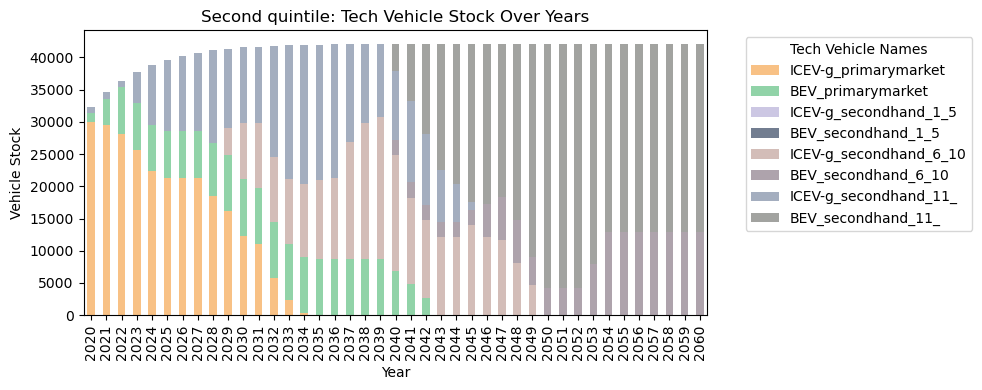

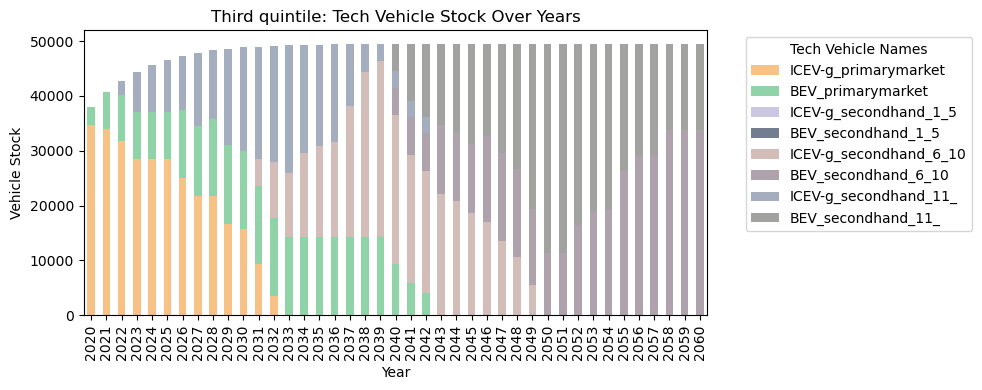

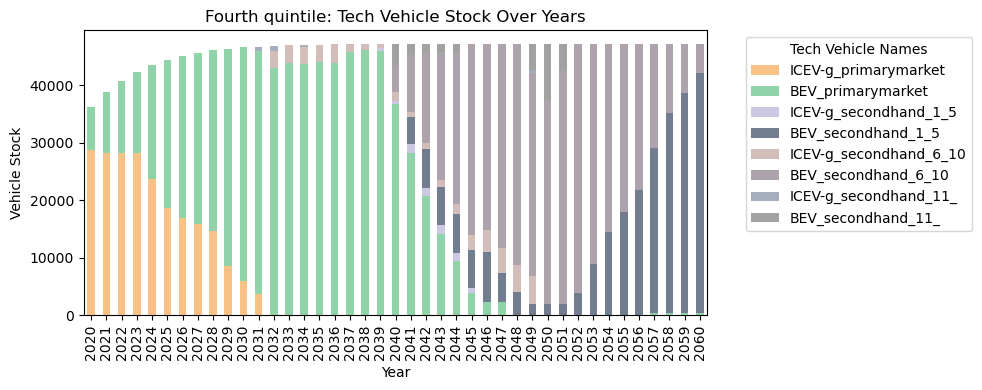

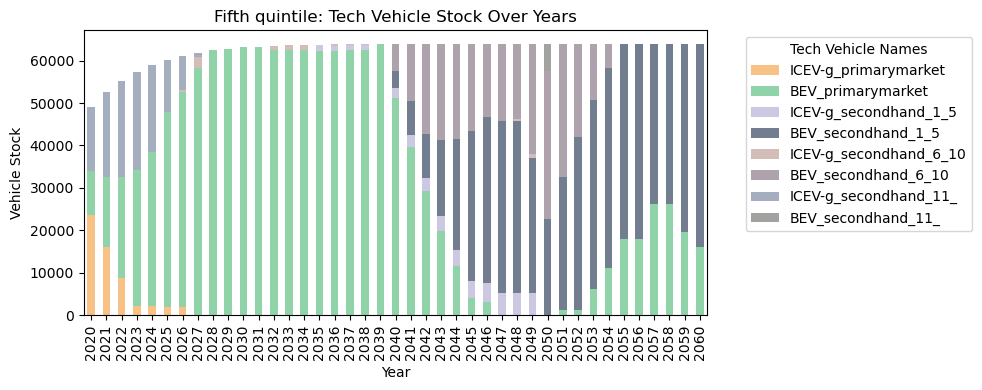

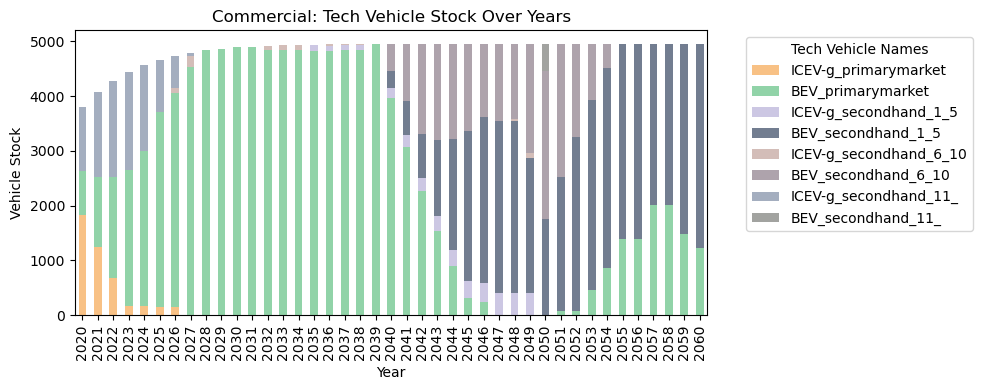

In [92]:
financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_vehicle_stock(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year, tech_id), 0) for tech_id in tech_ids] for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color=colors_techvehicles, alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Vehicle Stock')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)


In [93]:
# looking a budget penalties
# def get_budget_penalty_total(by_income_class = False, income_class=None):
#     budget_pen = {}

#     # for tv_id in techvehicle_list:

#     for y in range(y_init, Y_end + 1):
#         if not by_income_class:
#             total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
#         else:
#             total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
#         budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
#     return budget_pen

# financial_status_list = input_data["FinancialStatus"]
# financial_status_list = {item["id"]: item for item in financial_status_list}
# for fin in financial_status_list.keys():
#     tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
#     fig, ax = plt.subplots(figsize=(10, 4))

#     years = range(y_init, Y_end + 1)
#     tech_ids = list(techvehicle_list.keys())

#     techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

#     # Prepare data for stacked bar plot
    
#     data = {year: [techveh_stock_all.get((year))]for year in years}
#     df = pd.DataFrame(data, index=tech_ids).T

#     # Plotting
#     bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
#     ax.set_xlabel('Year')
#     ax.set_ylabel('Budget compensation')
#     ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
#     handles, _ = ax.get_legend_handles_labels()
#     ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

#     plt.tight_layout()
#     plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
# print(budget_penalty_plus)

In [94]:
# looking a budget penalties
# def get_budget_penalty_total_yearly(by_income_class = False, income_class=None):
#     budget_pen = {}

#     # for tv_id in techvehicle_list:

#     for y in range(y_init, Y_end + 1):
#         if not by_income_class:
#             total_budget_nb_plus = sum(budget_penalty_plus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
#         else:
#             total_budget_nb_plus = sum(budget_penalty_plus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
#         budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
#     return budget_pen

# financial_status_list = input_data["FinancialStatus"]
# financial_status_list = {item["id"]: item for item in financial_status_list}
# for fin in financial_status_list.keys():
#     tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
#     fig, ax = plt.subplots(figsize=(10, 4))

#     years = range(y_init, Y_end + 1)
#     tech_ids = list(techvehicle_list.keys())

#     techveh_stock_all = get_budget_penalty_total_yearly(by_income_class=True, income_class=financial_status_list[fin]["name"])

#     # Prepare data for stacked bar plot
    
#     data = {year: [techveh_stock_all.get((year))]for year in years}
#     df = pd.DataFrame(data, index=tech_ids).T

#     # Plotting
#     bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
#     ax.set_xlabel('Year')
#     ax.set_ylabel('Budget compensation')
#     ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
#     handles, _ = ax.get_legend_handles_labels()
#     ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

#     plt.tight_layout()
#     plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
# print(budget_penalty_plus)

{(2044, 36): 0.0, (2058, 26): 0.0, (2055, 28): 0.0, (2032, 20): 0.0, (2045, 12): 0.0, (2059, 36): 0.0, (2060, 10): 0.0, (2021, 7): 0.0, (2046, 21): 0.0, (2057, 5): 0.0, (2033, 37): 0.0, (2044, 8): 0.0, (2027, 6): 0.0, (2039, 18): 0.0, (2056, 24): 0.0, (2033, 28): 0.0, (2036, 13): 0.0, (2022, 29): 0.0, (2059, 2): 0.0, (2021, 0): 0.0, (2023, 29): 0.0, (2027, 24): 0.0, (2060, 29): 0.0, (2046, 13): 0.0, (2048, 30): 0.0, (2031, 11): 0.0, (2022, 12): 0.0, (2032, 30): 0.0, (2044, 24): 0.0, (2046, 3): 0.0, (2024, 26): 0.0, (2039, 23): 0.0, (2056, 33): 0.0, (2060, 8): 0.0, (2055, 25): 0.0, (2022, 15): 0.0, (2046, 19): 0.0, (2032, 34): 0.0, (2034, 21): 0.0, (2054, 26): 0.0, (2059, 1): 0.0, (2041, 19): 0.0, (2036, 18): 0.0, (2059, 7): 0.0, (2056, 38): 0.0, (2030, 38): 0.0, (2031, 1): 0.0, (2041, 37): 0.0, (2030, 37): 0.0, (2022, 19): 0.0, (2049, 29): 0.0, (2060, 20): 0.0, (2020, 29): 0.0, (2028, 20): 0.0, (2055, 27): 0.0, (2023, 26): 0.0, (2022, 35): 0.0, (2042, 6): 0.0, (2057, 7): 0.0, (2029, 10

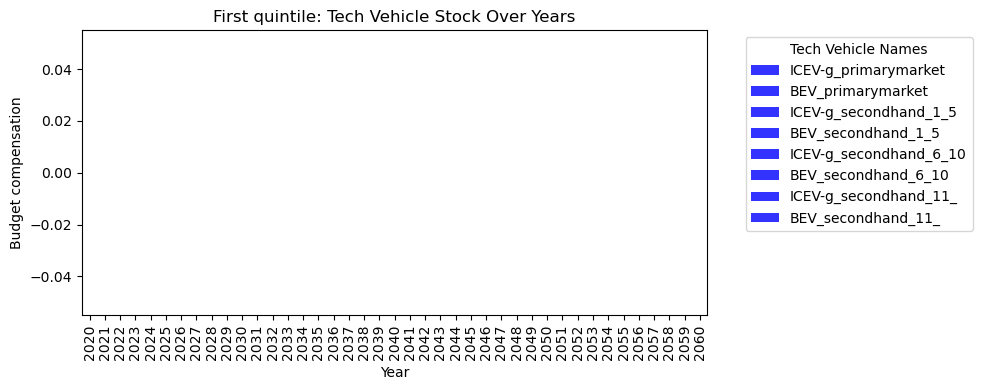

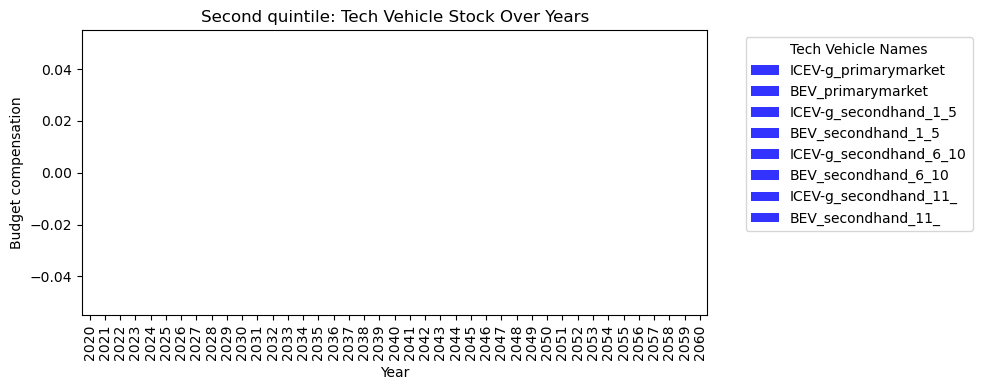

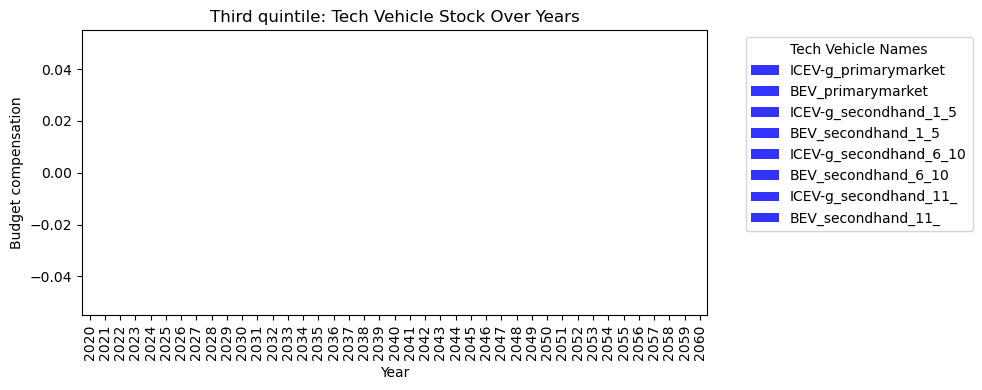

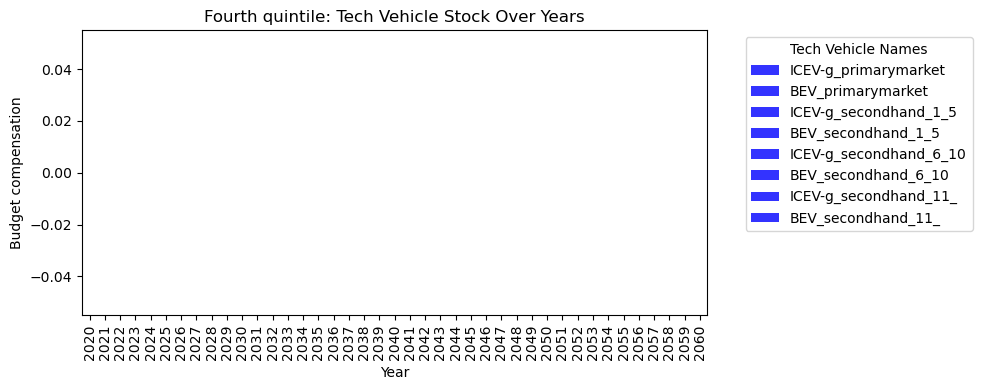

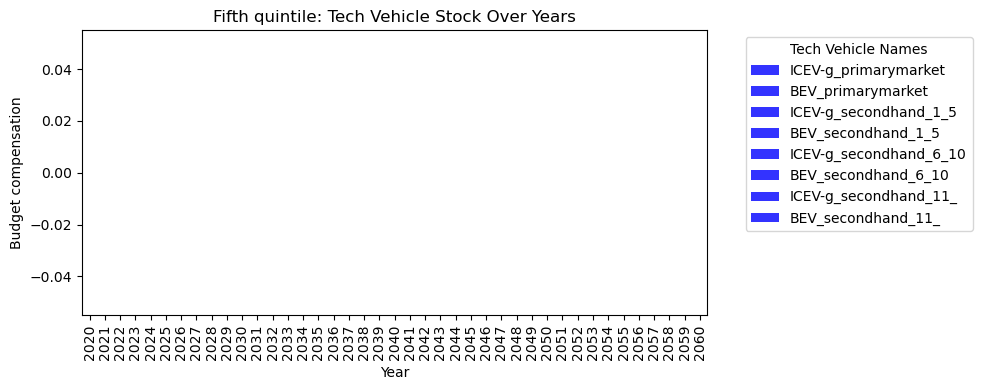

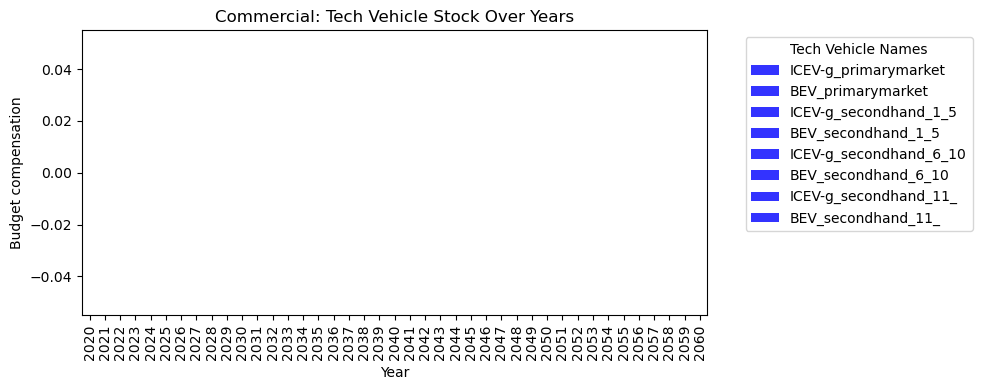

In [95]:
# looking a budget penalties
def get_budget_penalty_total(by_income_class = False, income_class=None):
    budget_pen = {}

    # for tv_id in techvehicle_list:

    for y in range(y_init, Y_end + 1):
        if not by_income_class:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
        else:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
    return budget_pen

financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year))]for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Budget compensation')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
print(budget_penalty_plus)


## Fueling infrastructure investments

In [96]:
technology_list = input_data["Technology"]
technology_list = {item["id"]: item for item in technology_list}
geographic_element_list = input_data["GeographicElement"]
geographic_element_list = {item["id"]: item for item in geographic_element_list}
fuel_infr_type_list = input_data["FuelingInfrTypes"]
fuel_infr_type_list = {item["id"]: item for item in fuel_infr_type_list}
fuel_list = input_data["Fuel"]
fuel_list = {item["id"]: item for item in fuel_list}

def get_fuel_infr_plus(by_geographic_element = False, geographic_element=[]):
    q_plus_by_tech = {}


    
    for f in fuel_list.keys():
        for l in fuel_infr_type_list.keys():
            if fuel_infr_type_list[l]["fuel"] == fuel_list[f]["name"]:
                if not by_geographic_element:
                    geographic_element = geographic_element_list.keys()
                    for e in geographic_element:
                        for y in range(y_init, Y_end + 1):
                            if not fuel_infr_type_list[l]["fueling_type"] == "home":
                                total_expansion_per_y = sum(q_fuel_infr_plus[(y0, (f, l), e)] for y0 in range(y_init, y+1) if (y0, (f, l), e) in q_fuel_infr_plus.keys())
                                q_plus_by_tech[(y, (f, l), e)] = total_expansion_per_y
                            else: 
                                total_expansion_per_y = sum(q_fuel_infr_plus_by_route[(y0, r, (f, l), e)] for r in odpair_list.keys() for y0 in range(y_init, y+1) if (y0, r, (f, l), e) in q_fuel_infr_plus_by_route.keys())
                                q_plus_by_tech[(y, (f, l), e)] = total_expansion_per_y
                else:
                    for y in range(y_init, Y_end + 1):
                        if not fuel_infr_type_list[l]["fueling_type"] == "home":
                            total_expansion_per_y = sum(q_fuel_infr_plus[(y0, (f, l), e)] for y0 in range(y_init, y+1) for e in geographic_element if (y0, (f, l), e) in q_fuel_infr_plus.keys())
                            q_plus_by_tech[(y, (f,l))] = total_expansion_per_y
                        else:
                            total_expansion_per_y = sum(q_fuel_infr_plus_by_route[(y0, r, (f, l), e)] for e in geographic_element for r in odpair_list.keys() for y0 in range(y_init, y+1) if (y0, r, (f, l), e) in q_fuel_infr_plus_by_route.keys())
                            q_plus_by_tech[(y, (f, l))] = total_expansion_per_y
            
    return q_plus_by_tech

In [97]:
q_plus_by_tech = get_fuel_infr_plus()

print(sum(q_plus_by_tech.values()))
print(sum(q_fuel_infr_plus.values()))
print(q_plus_by_tech)
print(q_fuel_infr_plus)

2675784832.958526
67724486.985696
{(2020, (1, 4), 1): 31232388.394916, (2021, (1, 4), 1): 31232388.394916, (2022, (1, 4), 1): 31232388.394916, (2023, (1, 4), 1): 31232388.394916, (2024, (1, 4), 1): 31232388.394916, (2025, (1, 4), 1): 31232388.394916, (2026, (1, 4), 1): 31232388.394916, (2027, (1, 4), 1): 31232388.394916, (2028, (1, 4), 1): 31232388.394916, (2029, (1, 4), 1): 31232388.394916, (2030, (1, 4), 1): 31232388.394916, (2031, (1, 4), 1): 31232388.394916, (2032, (1, 4), 1): 31232388.394916, (2033, (1, 4), 1): 31232388.394916, (2034, (1, 4), 1): 31232388.394916, (2035, (1, 4), 1): 31232388.394916, (2036, (1, 4), 1): 31232388.394916, (2037, (1, 4), 1): 31232388.394916, (2038, (1, 4), 1): 31232388.394916, (2039, (1, 4), 1): 31232388.394916, (2040, (1, 4), 1): 31232388.394916, (2041, (1, 4), 1): 31232388.394916, (2042, (1, 4), 1): 31232388.394916, (2043, (1, 4), 1): 31232388.394916, (2044, (1, 4), 1): 31232388.394916, (2045, (1, 4), 1): 31232388.394916, (2046, (1, 4), 1): 31232388.3

In [98]:
print(sum(q_fuel_infr_plus_by_route.values()))

326318.89786099986


In [99]:
print(9275551 - 27276 + 50007 + 77284 + 90923 + 90923 + 1372270)

10929682


{2020: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2021: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2022: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2023: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2024: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2025: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2026: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2027: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2028: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2029: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2030: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2031: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2032: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2033: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2034: [0.0, 1372270.113754, 26383431.900969, 5276686.380194, 0], 2035: [0.0, 1372270.1137

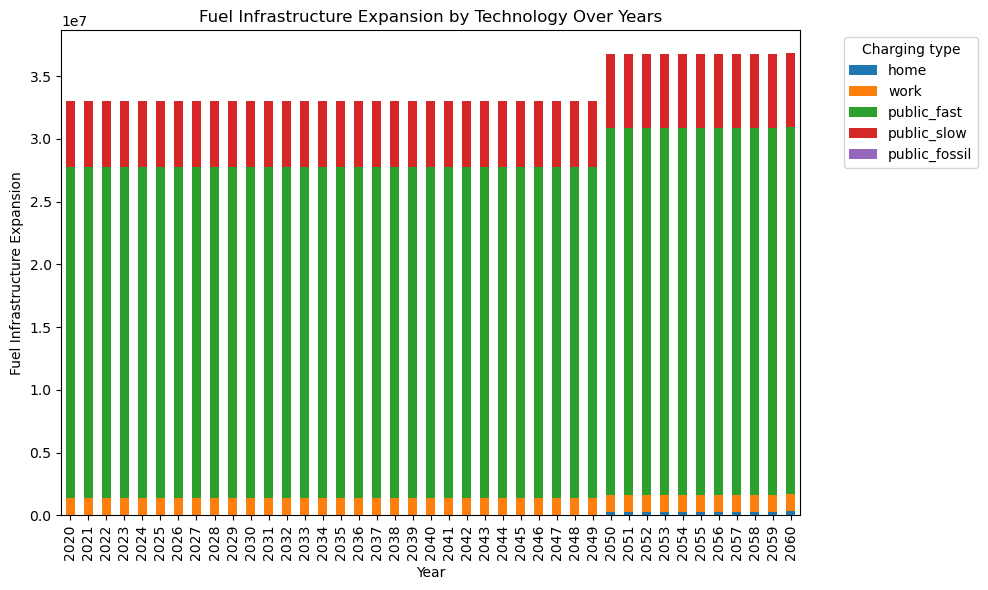

In [100]:
elems_of_interest = [12, 13, 14]

q_plus_by_tech = get_fuel_infr_plus()
# total charging infrastructure 
fuel = "electricity"
f_id = 2
fig, ax = plt.subplots(figsize=(10, 6))

years = range(y_init, Y_end + 1)
tech_ids = list(technology_list.keys())
fuel_type_ids = list(fuel_infr_type_list.keys())
# Prepare data for stacked bar plot
data = {year: [sum([q_plus_by_tech.get((year, (f_id, l), geo)) for geo in geographic_element_list if (year, (f_id, l), geo) in q_plus_by_tech.keys()]) for l in fuel_type_ids] for year in years}
print(data, len(fuel_type_ids), len(tech_ids))
df = pd.DataFrame(data, index=fuel_type_ids).T
print(df)
# Plotting
df.plot(kind='bar', stacked=True, ax=ax)

# Set x and y labels
ax.set_xlabel('Year')
ax.set_ylabel('Fuel Infrastructure Expansion')
ax.set_title('Fuel Infrastructure Expansion by Technology Over Years')

# Set legend labels to fueling_type names
charging_type_labels = [fuel_infr_type_list[l]["fueling_type"] for l in fuel_type_ids]
plt.legend(title='Charging type', labels=charging_type_labels, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()



KeyError: 12

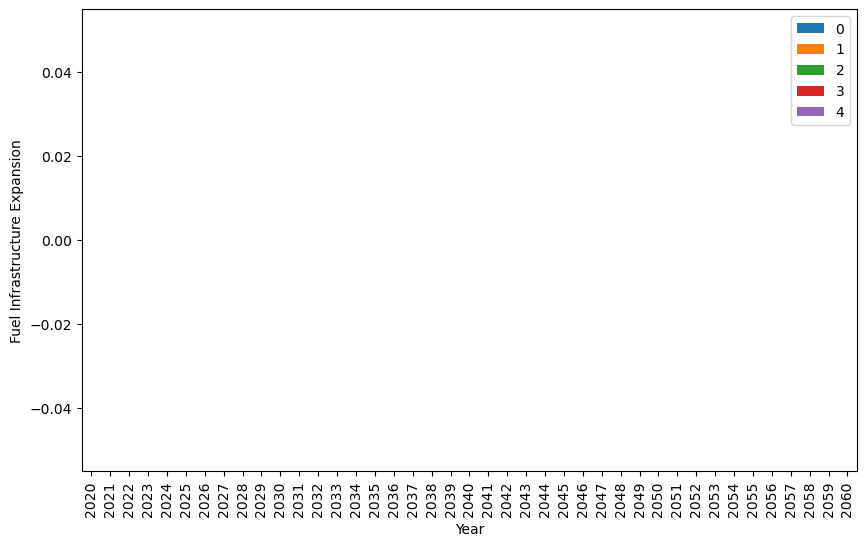

In [101]:
geos_of_interest = [12, 13, 14]
for geo in geos_of_interest:
    fig, ax = plt.subplots(figsize=(10, 6))

    years = range(y_init, Y_end + 1)
    fuel_type_ids
    fuel_type_ids = list(fuel_infr_type_list.keys())
    # Prepare data for stacked bar plot
    f_id = 2
    data = {year: [sum([q_plus_by_tech.get((year, (f_id, l), g)) for g in geographic_element_list if (year, (f_id, l), g) in q_plus_by_tech.keys() and g == geo]) for l in fuel_type_ids] for year in years}
    # print(data)
    df = pd.DataFrame(data, index=fuel_type_ids).T
    # print(df)
    # Plotting
    df.plot(kind='bar', stacked=True, ax=ax)
    ax.set_xlabel('Year')
    ax.set_ylabel('Fuel Infrastructure Expansion')
    ax.set_title('Fuel Infrastructure Expansion by Technology Over Years - ' + geographic_element_list[geo]["name"])
    plt.legend(title='Charging type', bbox_to_anchor=(1.05, 1), loc='upper left', labels=[fuel_infr_type_list[l]["fueling_type"] for l in fuel_type_ids])
    plt.tight_layout()
    plt.show()

In [ ]:
installed_infrastructure_2050 = {}

for l in fuel_infr_type_list.keys():
    total_installed = sum(
        q_fuel_infr_plus[(y, (f_id, l), e)]
        for y in range(y_init, 2051)
        for e in geographic_element_list.keys()
        if (y, (f_id, l), e) in q_fuel_infr_plus
    )
    installed_infrastructure_2050[l] = total_installed

for l in fuel_infr_type_list.keys():
    print(f"{fuel_infr_type_list[l]['fueling_type']}: {installed_infrastructure_2050[l]}")

In [ ]:
financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
od_pair_list = input_data["Odpair"]
od_pair_list = {item["id"]: item for item in od_pair_list}
for fin in financial_status_list.keys():
    fin_name = financial_status_list[fin]["name"]
    s__by_ldict = {}
    for y in range(y_init, Y_end + 1):
        for l in fuel_type_ids:
            total_s = sum(s[(y, (1, r, od_pair_list[r]["path_id"], geo), tv_id, (f_id, l), g)] for f_id in [1, 2] for geo in geographic_element_list.keys() for g in range(g_init, y + 1) for r in od_pair_list.keys() for tv_id in techvehicle_list.keys() if (y, (1, r, od_pair_list[r]["path_id"], geo), tv_id, (f_id, l), g) in s_dict.keys() and odpair_list[r]["financial_status"] == fin_name)
            s__by_ldict[(y, l)] = total_s

    years = range(y_init, Y_end + 1)
    l_ids = list(fuel_type_ids)
    data = {year: [s__by_ldict.get((year, l)) for l in l_ids] for year in years}
    df = pd.DataFrame(data, index=l_ids).T

    fig, ax = plt.subplots(figsize=(10, 6))
    df.plot(kind='bar', stacked=True, ax=ax)
    ax.set_xlabel('Year')
    ax.set_ylabel('s value')
    ax.set_title(f's_dict for {fin_name}')
    ax.legend(title='Fuel Type ID', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

In [ ]:
# for each geom_item

geometric_element_list = input_data["GeographicElement"]

geometric_element_list = {item["id"]: item for item in geometric_element_list}

for e in geographic_element_list.keys():
    q_plus_by_tech = get_fuel_infr_plus(True, [e])

    fig, ax = plt.subplots(figsize=(10, 6))

    years = range(y_init, Y_end + 1)
    tech_ids = list(technology_list.keys())

    # Prepare data for stacked bar plot
    data = {year: [q_plus_by_tech.get((year, tech_id), 0) for tech_id in tech_ids] for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    df.plot(kind='bar', stacked=True, ax=ax)
    ax.set_xlabel('Year')
    ax.set_ylabel('Fuel Infrastructure Expansion')
    ax.set_title(str(geographic_element_list[e]["name"]) + ': Fuel Infrastructure Expansion by Technology Over Years')
    plt.legend(title='Technology ID', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

In [ ]:
# installed cap per e 

geometric_element_list = input_data["GeographicElement"]

geometric_element_list = {item["id"]: item for item in geometric_element_list}
for e in geographic_element_list.keys():
    for fuel in fuel_list.keys():
        total_expansion_per_y = sum(q_fuel_infr_plus[(y, fuel, e)] for y in range(y_init, Y_end+1) if (y, fuel, e) in q_fuel_infr_plus.keys())
        if geographic_element_list[e]["name"] in ["ES213", "ES211", "ES212"]:
            print(geographic_element_list[e]["name"], fuel_list[fuel]["name"], total_expansion_per_y)


In [ ]:
def get_s_per_year_and_tech(tech_id_list = ["diesel", "electricity"]):
    s_per_year_and_tech = {}

    for t in tech_id_list:
        for y in range(y_init, Y_end + 1):
            total_s_per_y = sum(s[(y, (1, r, odpair_list[r]["path_id"], e), tv)] for r in odpair_list.keys() for tv in technology_list.keys() for e in geographic_element_list.keys() if (y, (1, r, odpair_list[r]["path_id"], e), tv) in s.keys() and technology_list[techvehicle_list[tv]["technology"]]["fuel"] in (tech_id_list))
            s_per_year_and_tech[(y, t)] = total_s_per_y
    return s_per_year_and_tech


In [ ]:
energy_fueled_diesel = get_s_per_year_and_tech(tech_id_list=["diesel"])
energy_fueled_electricity = get_s_per_year_and_tech(tech_id_list=["electricity"])
print(energy_fueled_diesel)
print(energy_fueled_electricity)

In [ ]:
# check total investments per technology
data = {year: [q_plus_by_tech.get((year, tech_id), 0) for tech_id in tech_ids if tech_id == 1] for year in years}
print(data)


In [ ]:
# check tech_shift 
technology_list = input_data["Technology"]
technology_list = {item["id"]: item for item in technology_list}
def get_f_per_tech(tech_id_list = ["diesel", "electricity"]):
    f_per_tech_and_year = {}
    for t in tech_id_list:
        for y in range(y_init, Y_end + 1):
            total_activity_per_tech = sum(f[(y, (1, r, odpair_list[r]["path_id"]), (1, tv), g)] for r in odpair_list.keys() for tv in techvehicle_list.keys() for g in range(g_init, y + 1) if (y, (1, r, odpair_list[r]["path_id"]), (1, tv), g) in f.keys() and technology_list[techvehicle_list[tv]["technology"]]["fuel"] in tech_id_list)
            f_per_tech_and_year[(y, t)] = total_activity_per_tech
    return f_per_tech_and_year

In [ ]:
f_per_tech_diesel = get_f_per_tech(tech_id_list=["diesel"])
f_per_tech_electricity = get_f_per_tech(tech_id_list=["electricity"])
print(f_per_tech_diesel)
print(f_per_tech_electricity)



In [ ]:
def get_f_by_mode(mode_list=[1, 2]):
    f_per_mode = {}
    for m in mode_list:
        for y in range(y_init, Y_end + 1):
            total_activity_per_tech = sum(f[(y, (1, r, odpair_list[r]["path_id"]), (m, tv), g)] for r in odpair_list.keys() for tv in range(1, max(techvehicle_list.keys()) + 2) for g in range(g_init, y + 1) if (y, (1, r, odpair_list[r]["path_id"]), (m, tv), g) in f.keys())
            f_per_mode[(y, m)] = total_activity_per_tech
    return f_per_mode

In [ ]:
f_per_mode_1 = get_f_by_mode(mode_list=[1])
f_per_mode_2 = get_f_by_mode(mode_list=[2])
print(f_per_mode_1)
print(f_per_mode_2)

print("f_per_mode_1", sum(f_per_mode_1.values()))
print("f_per_mode_2", sum(f_per_mode_2.values()))

In [ ]:
f_per_tech = get_f_per_tech()
print(f_per_tech)
print(fuel_list)
print(od_pair_list_by_year)
print(technology_list.keys())
for y in range(y_init, Y_end + 1):
    val1 = sum(f_per_tech[(y, fuel_list[f]["name"])] for f in fuel_list.keys())
    val2 = od_pair_list_by_year[y]
    print(f"Year: {y}", val1, val2, val1 - val2, val1 >= val2)




In [ ]:
mode_list = input_data["Mode"]
mode_list = {item["id"]: item for item in mode_list}
product_list = input_data["Product"]
product_list = {item["id"]: item for item in product_list}
vehicle_type_list = input_data["Vehicletype"]
vehicle_type_list = {item["name"]: item for item in vehicle_type_list}
path_list = input_data["Path"]
path_list = {item["id"]: item for item in path_list}

for y in range(y_init, 2022):
    for r in range(1, 4):
        val1 = sum(f[(y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g)] for mode_id in [1, 2] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, 5) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys())
        val2 = odpair_list[r]["F"][y - y_init]
        print(f"Year: {y}, Odpair: {r}", val1, val2, val1 - val2)


## Mode shift

- by trip
- by pkm

In [ ]:
F_sum = 0
mode_list = input_data["Mode"]
mode_list = {item["id"]: item for item in mode_list}
product_list = input_data["Product"]
product_list = {item["id"]: item for item in product_list}
vehicle_type_list = input_data["Vehicletype"]
vehicle_type_list = {item["name"]: item for item in vehicle_type_list}
path_list = input_data["Path"]
path_list = {item["id"]: item for item in path_list}
print(path_list)
activity_per_mode =  {}
financial_status_list = ["Commercial", "First quintile", "Second quintile", "Third quintile", "Fourth quintile", "Fifth quintile"]
# financial_status_list = ["Commercial"]

activity_per_mode_pkm = {}
for mode in mode_list.keys():
    mode_id = mode_list[mode]["id"]
    mode_name = mode_list[mode]["name"]

    for y in range(y_init, Y_end):
        total_activity_per_mode = sum(f[(y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g)] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, len(odpair_list)) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys() and odpair_list[r]["financial_status"] in financial_status_list)
        
        total_activity_per_mode_pkm = sum(f[(y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g)] * path_list[odpair_list[r]["path_id"]]["length"] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, 17) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys() and odpair_list[r]["financial_status"] in financial_status_list)
        if y == 2020:
            F_sum = total_activity_per_mode_pkm + F_sum
        total_pkm = sum(path_list[odpair_list[r]["path_id"]]["length"] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, 17) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys() and odpair_list[r]["financial_status"] in financial_status_list)
        activity_per_mode[(y, mode_id)] = total_activity_per_mode
        activity_per_mode_pkm[(y, mode_id)] = total_activity_per_mode_pkm
        print("Year:", y, "Mode:", mode_name, "Activity:", total_activity_per_mode, "Activity pkm:", total_activity_per_mode_pkm, total_pkm)

print("F_sum:", F_sum)


In [ ]:

fig, ax = plt.subplots(figsize=(10, 6))

years = range(y_init, Y_end + 1)
mode_ids = list(set(mode_id for _, mode_id in activity_per_mode.keys()))

# Prepare data for stacked bar plot
data = {year: [activity_per_mode.get((year, mode_id), 0) for mode_id in mode_ids] for year in years}
df = pd.DataFrame(data, index=mode_ids).T

# Plotting
df.plot(kind='bar', stacked=True, ax=ax)
ax.set_xlabel('Year')
ax.set_ylabel('Activity per Mode')
ax.set_title('Activity per Mode Over Years')
plt.legend(title='Mode ID', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()
activity_per_mode


In [ ]:
mode_names = {1: "Road", 2: "Public transport"}

fig, ax = plt.subplots(figsize=(10, 4))

years = range(y_init, Y_end + 1)
mode_ids = list(set(mode_id for _, mode_id in activity_per_mode_pkm.keys()))

# Prepare data for stacked bar plot
data = {year: [activity_per_mode_pkm.get((year, mode_id), 0) for mode_id in mode_ids] for year in years}
df = pd.DataFrame(data, index=mode_ids).T

# Plotting
df.plot(kind='bar', stacked=True, ax=ax, color = ["#432371", "#faae7b"], alpha=0.8, width=0.8)
ax.set_xlabel('Year')
ax.set_ylabel('Transport activity per Mode (pkm)')
ax.set_title('Transport activity per Mode Over Years')
ax.legend(
    labels=[mode_names[mode_id] for mode_id in mode_ids],
    title='Mode shift from road to public transport',
    bbox_to_anchor=(1.05, 1),
    loc='upper left'
)
plt.tight_layout()
plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_activity_per_mode_pkm.png"), transparent=True)
plt.show()
print(activity_per_mode_pkm[(2020, 1)]/ (1.4 * 14600))
print(activity_per_mode_pkm[(2020, 1)])

In [ ]:
print(mode_list.keys())

In [ ]:
geometric_element_list = input_data["GeographicElement"]

geometric_element_list_by_id = {item["id"]: item for item in geometric_element_list}
geometric_element_list_by_name = {item["name"]: item for item in geometric_element_list}

fuel_list = input_data["Fuel"]
fuel_list_by_id = {item["id"]: item for item in fuel_list}
fuel_list_by_name = {item["name"]: item for item in fuel_list}

# Development of detour time by edge
def get_detour_time_by_edge(by_geom = False, by_fuel = False, geoms = [], fuels = []):
    if by_geom:
        geom_list = geoms
    else:
        geom_list = geometric_element_list_by_name.keys()

    if by_fuel:
        fuels_list = fuels
    else:
        fuels_list = fuel_list.keys()

    detour_time_by_edge = {}
    detour_time_at_place = {}
    for y in range(y_init, Y_end + 1):
        for e in geom_list:
            for fuel in fuels_list:
                tot_veh = 0
                fuel_id = fuel_list_by_name[fuel]["id"]
                for r in odpair_list.keys():
                    # if (y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"]) in detour_time.keys():
                    fueling_vehs = n_fueling[(y, (1, r, odpair_list[r]["path_id"], geometric_element_list_by_name[e]["id"]), fuel_id)]
                        # print(r, fueling_vehs)
                    tot_veh = tot_veh + fueling_vehs
                        # total_detour_time_per_y = sum(detour_time[(y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"])])
                        # detour_time_by_edge[(y, geometric_element_list_by_name[e]["id"], fuel)] = total_detour_time_per_y
                print (y, tot_veh)
                total_detour_time_per_y = sum(detour_time[(y, (p, r, odpair_list[r]["path_id"], geometric_element_list_by_name[e]["id"]), fuel_list_by_name[fuel]["id"])] for r in odpair_list.keys() for p in product_list.keys() if (y, (p, r, odpair_list[r]["path_id"], geometric_element_list_by_name[e]["id"]), fuel_list_by_name[fuel]["id"]) in detour_time.keys())
                if not tot_veh == 0:

                    detour_time_av = total_detour_time_per_y / tot_veh
                else:
                    detour_time_av = 0
                detour_time_by_edge[(y, geometric_element_list_by_name[e]["id"], fuel)] = total_detour_time_per_y
                detour_time_at_place[(y, geometric_element_list_by_name[e]["id"], fuel)] = detour_time_av
    return detour_time_by_edge, detour_time_at_place

In [ ]:
# electricity 
# getting detour time 
detour_time_by_edge, detour_time_at_place = get_detour_time_by_edge(by_geom=True, by_fuel=True, geoms=["ES211"], fuels=["electricity"])

for k in detour_time_at_place.keys():
    print(k, detour_time_at_place[k])
print(detour_time_at_place)

In [ ]:
# diesel
detour_time_by_edge, detour_time_by_place = get_detour_time_by_edge(by_geom=True, by_fuel=True, geoms=["ES211"], fuels=["diesel"])

for k in detour_time_at_place.keys():
    print(k, detour_time_at_place[k])
print(detour_time_at_place)

In [ ]:
geometric_element_list = input_data["GeographicElement"]

geometric_element_list_by_id = {item["id"]: item for item in geometric_element_list}
geometric_element_list_by_name = {item["name"]: item for item in geometric_element_list}

fuel_list = input_data["Fuel"]
fuel_list_by_id = {item["id"]: item for item in fuel_list}
fuel_list_by_name = {item["name"]: item for item in fuel_list}

# Development of detour time by edge
def get_nb_vehs(by_geom = False, by_fuel = False, geoms = [], fuels = []):
    if by_geom:
        geom_list = geoms
    else:
        geom_list = geometric_element_list_by_name.keys()

    if by_fuel:
        fuels_list = fuels
    else:
        fuels_list = fuel_list.keys()

    nb_vehs_fueling = {}
    detour_time_at_place = {}
    for y in range(y_init, Y_end + 1):
        for e in geom_list:
            for fuel in fuels_list:
                tot_veh = 0

                for r in odpair_list.keys():
                    if (y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"]) in detour_time.keys():
                        fueling_vehs = sum(n_fueling[(y, (1, r, odpair_list[r]["path_id"], e), tv)] for tv in techvehicle_list.keys() for e in geographic_element_list.keys() if (y, (1, r, odpair_list[r]["path_id"], e), tv) in n_fueling.keys() and technology_list[techvehicle_list[tv]["technology"]]["fuel"] in fuels_list)
                        # print(r, fueling_vehs)
                        tot_veh = tot_veh + fueling_vehs
                        # total_detour_time_per_y = sum(detour_time[(y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"])])
                        # detour_time_by_edge[(y, geometric_element_list_by_name[e]["id"], fuel)] = total_detour_time_per_y
                print (y, tot_veh)
                
                nb_vehs_fueling[(y, geometric_element_list_by_name[e]["id"], fuel)] = tot_veh
    return nb_vehs_fueling

In [ ]:
nb_vehs_fueling = get_nb_vehs(by_geom=True, by_fuel=True, geoms=["ES211"], fuels=["electricity"])
print(nb_vehs_fueling)